In [ ]:
using PyPlot, ODE, Dierckx
set_bigfloat_precision(128);

In [2]:
1+1

2

In [3]:
function thin_lens(r0, rmin_sim, endy=0.0, N=100)
    const tgθ = rmin_sim/r0
    const t = r0 #0/(1.0+tgθ*tgθ)
    const x0 = 0.0 #-r0+t
    const y0 = t*tgθ
    const b = sqrt(x0*x0+y0*y0)
    const θ=atan(tgθ)
    const nθ = θ-2.0/b
    const tgnθ = tan(nθ)
    const nx = (-y0+endy)/tgnθ
    
    lx = linspace(big"0.0",big"1.0",div(N,2)).^3
    x = [-reverse(lx)*(x0+r0)+x0; lx*nx+x0]
    y = zeros(length(x))
    for i in 1:length(x)
        y[i] = if x[i]<x0
            tgθ*x[i]+y0
        else
            y[i] = y0+tgnθ*(x[i]-x0)
        end
    end
    x = [(xx) for xx in x]
    y = [(yy) for yy in y]        
    x, y
end

function direct_lens(r0, rmin_sim, endy=0.0, N=100)
    tx, ty = thin_lens(r0, rmin_sim, endy, N)
    ϕf = π-atan(ty[end]/tx[end])
    function f(ϕ, y)
        (u, v) = y
        u_prime = v
        v_prime = 3/2*u*u-u
        [u_prime; v_prime]    
    end
    const u0 = 1.0/r0
    const tgθ = rmin_sim/r0
    const du0 = 1.0/(r0*abs(tgθ))
    start = [u0; du0];
    ϕl=linspace(0,ϕf,N)
    
    ϕ, y = ode45(f, start, ϕl, abstol=1.0e-26, reltol=1.0e-36);
    u = map(y -> y[1], y);
    x = [(v) for v in -cos(ϕ)./u]
    y = [(v) for v in sin(ϕ)./u]        
    spl = Spline1D(x,y, k=5, bc="extrapolate")
    
    t = (endy-y[end-100])/(y[end]-y[end-100])
    xmax = x[end-100]+t*(x[end]-x[end-100])
    
    #xmax = fzero(xx->evaluate(spl,xx)-endy, x[end]; order=8)    
    lx = linspace(big"0.0",big"1.0",div(N,2)).^3
    x = [-reverse(lx)*r0; lx*xmax]
    y = evaluate(spl, x)

    x,y
end

function opt_target(fn, tx, ty, r0, rsim_min, fac, M=10)
    display("!!!!!!!!!!!!!!!!!!!!!!!!!!")
    iter = 0
    x = zeros(100000)
    y = zeros(100000)
    positive=false
    while true
        iter += 1
        iter>5000 && error("maximum iterations reached!")
        x,y = fn(r0, rsim_min, ty, 100000);

        dx = tx-x[end]
        if iter % M == 0
            display(string(dx)*", "*string(fac)*", "*string(rsim_min))
        end
        if dx>0.0000000001
            rsim_min +=fac
            if positive
                fac*=0.995
            else
                fac *= 0.5
            end
            positive=true
            continue
        end
        if dx<-0.0000000001
            rsim_min -=fac
            if !positive
                fac*=0.995
            else
                fac *= 0.5
            end
            positive=false
            continue
        end
        break
    end
    rsim_min, fac, x, y
end
    
function opt(dy, r0, u_rsim_min, N=10000)
    dux,duy = direct_lens(r0, u_rsim_min, dy, 100000);
    tx = dux[end]
    ty = dy
    
    fac = 5.0
    rsim_min, fac, tux, tuy = opt_target(thin_lens, tx, ty, r0, u_rsim_min, fac)
    rsim_min, fac, tdx, tdy = opt_target(thin_lens, tx, -ty, r0, rsim_min, 2000)
    tdy = -tdy
    rsim_min, fac, ddx, ddy = opt_target(direct_lens, tx, -ty, r0, rsim_min, 1, 1)
    ddy = -ddy
    
    tdx,tdy,tux,tuy, ddx,ddy,dux,duy 
end

opt (generic function with 2 methods)

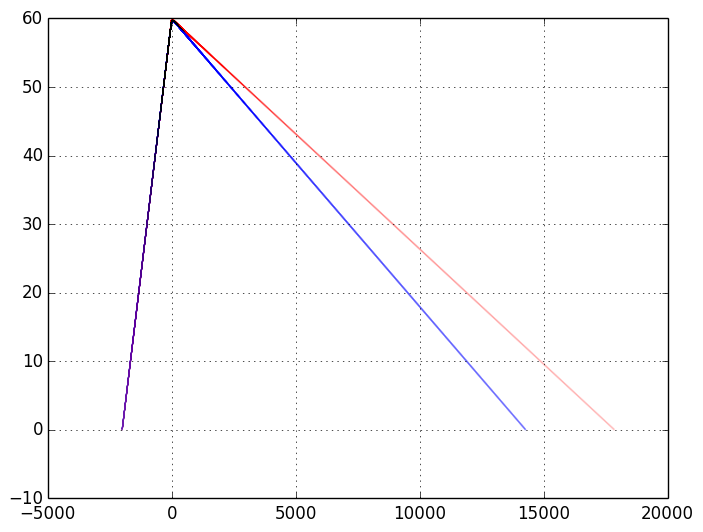

In [7]:
rmin_sim = big"60.0"
r0 = big"2.0e3"
endy = big"0.0"
dx,dy = direct_lens(r0, rmin_sim, endy, 100000);

tosmall(x) = [Float64(xi) for xi in x]
plot(tosmall(dx), tosmall(dy), ".b", ms=0.02, lw=1.1)
hold(true)
tx,ty = thin_lens(r0, rmin_sim, endy, 100000);
plot(tosmall(tx), tosmall(ty), ".r", ms=0.01, lw=0.01)
hold(false)
#xlim(-5000,5000)
#ylim(1066,1072)
grid(true)

In [7]:
dx[end]

1.287181905350378201831506259951307258387e+10

In [8]:
dx[end-100]

1.285637898655336634164929978668582442400e+10

In [4]:
dtx,dty,utx,uty, ddx,ddy,udx,udy = opt(big"-60000.0", big"2.0e10", big"100071.0", big"100000"); # setup1
#dtx,dty,utx,uty, ddx,ddy,udx,udy = opt(big"-95000.0", big"2.0e10", big"100071.0", big"100000"); # setup2
#dtx,dty,utx,uty, ddx,ddy,udx,udy = opt(big"-20.0", big"2.0e3", big"60.0", big"100000"); # setup3

"!!!!!!!!!!!!!!!!!!!!!!!!!!"

"2.41903817013518363567730368688333473212e+04, 0.076958974609375, 1.000700445156445312497039967780665392638e+05"

"-1.245563445144923350906570902692132629185e+02, 0.00029762230014705656, 1.000701438346433750359367473650729074564e+05"

"-1.692438269879469540989996193966984236409, 9.07049303499004e-6, 1.000701433327828705664722246950447404057e+05"

"8.758513347100301650436152086046776072136e-03, 6.980558431743113e-8, 1.00070143325834015474340947064046817086e+05"

"2.070595731567767627786898808311557836872e-04, 1.0690610720244758e-9, 1.000701433258689454799067629069265864313e+05"

"-5.868540398394378407670273518183199590305e-07, 2.077569856766315e-12, 1.000701433258697936504108001380031689104e+05"

"-1.856754683061651132908893438926791634637e-09, 8.03455506814481e-15, 1.000701433258697912608804387912584241269e+05"

"!!!!!!!!!!!!!!!!!!!!!!!!!!"

"6.751145317102124395236350767950043084888e+09, 960.6930435754368, 1.09931534610782416022624646055384677547e+05"

"5.188040294606726870591270063772306458939e+09, 913.7248860125932, 1.193251661233511414065961146008811413226e+05"

"3.248473100122700795745965143413431651247e+09, 869.0529955452599, 1.282595442168177669072920691434882103381e+05"

"8.262480885704446866649165156476854332783e+08, 826.565107974722, 1.367571217309253420053155862007878242907e+05"

"2.012361602875722244513156905919946916384e+06, 50.129753623235224, 1.391730397947741648236447401615913479504e+05"

"-9.746035378131271659565230691932023408141e+03, 0.767728952816692, 1.391787227261935861494918368436736857434e+05"

"-9.519348978431941859967757963496278949869e+02, 0.011757642964353667, 1.391786980137243237611820437888434200972e+05"

"-3.993282900830212388060142409931187758768e+01, 0.0001800663731255983, 1.391786954508887036852180374207079252018e+05"

"9.32881644970838397485848512689974529176e-02, 1.3857723437375165e-6, 1.391786953384104898968075606131111451329e+05"

"-6.535522539625108562646780406168913529393e-03, 1.0664761861606961e-8, 1.391786953386910064901471793260971088839e+05"

"-1.090609088924680504099972819128391791832e-05, 1.6332907832716577e-10, 1.391786953386726715314477928040475502419e+05"

"8.592693249873319063680174003932626976737e-07, 1.256963839195297e-12, 1.391786953386726384693673921617492308741e+05"

"7.168392445244197399857995589446142940323e-09, 1.9250194988921142e-14, 1.39178695338672640863873725005266203749e+05"

"!!!!!!!!!!!!!!!!!!!!!!!!!!"

"2.191888716410466473045436359686410990353e+05, 1, 1.391786953386726408837706211961151760847e+05"

"-1.366653548710036419258400414361810209994e+05, 0.5, 1.391796953386726408837706211961151760847e+05"

"4.126333063801545757241774304401707493188e+04, 0.25, 1.391791953386726408837706211961151760847e+05"

"-4.770061904845922152198706304986739868729e+04, 0.125, 1.391794453386726408837706211961151760847e+05"

"-3.218545938811468214897136107104266683242e+03, 0.0625, 1.391793203386726408837706211961151760847e+05"

"1.902241691612981066994225129879498764503e+04, 0.0621875, 1.391792578386726408837706211961151760847e+05"

"-3.107341002318038412732028906118566065013e+03, 0.03109375, 1.391793200261726408837703436403590197956e+05"

"7.957544037284270266070164690582539536868e+03, 0.015546875, 1.391792889324226408837704824182370979401e+05"

"2.425103037578863073207318395719649486129e+03, 0.0077734375, 1.391793044792976408837704130292980588679e+05"

"-3.411186023455069939772710543817029581365e+02, 0.0077345703125, 1.391793122527351408837703783348285393317e+05"

"2.411271931269860682459192439621745562636e+03, 0.00386728515625, 1.391793045181648283837700355534696863146e+05"

"1.035076758520494244297935771561202308262e+03, 0.001933642578125, 1.391793083854499846337702069441491128232e+05"

"3.469791016020751898872301646789996220535e+02, 0.001923974365234375, 1.391793103190925627587702926394888260774e+05"

"-3.376781137087840135411753154588616468794e+02, 0.0019143544934082032, 1.391793122430669279931453247804453889757e+05"

"3.435558156413390443061280914532953359378e+02, 0.0009571772467041016, 1.391793103287124345849420854008284999936e+05"

"2.938856728229131237635973258479678530702, 0.0004785886233520508, 1.391793112858896812890437050906369444847e+05"

"-1.673696270497895036083451648345466200546e+02, 0.00047619568023529057, 1.391793117644783046410945149355411667302e+05"

"2.087314316505470843064605020308370651284, 0.00023809784011764529, 1.391793112882826244058039439610310507988e+05"

"-8.264115601011225292583969354241797086907e+01, 0.00011904892005882264, 1.391793115263804645234492294482861087645e+05"

"-4.027692075767095069403870136879413078475e+01, 5.952446002941132e-5, 1.391793114073315444646265867046585797817e+05"

"-1.909480319829962990325679446009388637955e+01, 5.9226837729264266e-5, 1.391793113478070844352152653328448152903e+05"

"1.981403729042304233469322877947803907655, 5.893070354061794e-5, 1.391793112885802467059509993820439934653e+05"

"-1.898942216355316640406472928554924219311e+01, 2.946535177030897e-5, 1.391793113475109502465689407166029758344e+05"

"-8.504009211795236303047780502192185640518, 1.4732675885154485e-5, 1.391793113180455984762599700493234846499e+05"

"-3.26130274001141734020564544189278162631, 1.4659012505728713e-5, 1.391793113033129225911054847156837390576e+05"

"1.955190196703826827251650473966645541953, 1.4585717443200069e-5, 1.39179311288653910085376771571542966962e+05"

"-3.235220275321117535528050905123550934009, 7.2928587216000345e-6, 1.391793113032396275285768405655103015916e+05"

"-6.40015038974157405178007731257492756396e-01, 3.6464293608000172e-6, 1.391793112959467688069768060685266342768e+05"

"6.575875789484566982617341729354640521408e-01, 3.628197213996017e-6, 1.391793112923003394461767888200348006194e+05"

"-6.335270258841282346435719486735063361647e-01, 1.8140986069980085e-6, 1.39179311295928536660172805755702861718e+05"

"1.203027655286119628688986855047740209175e-02, 9.070493034990042e-7, 1.391793112941144380531747972878688311687e+05"

"-3.107483746604592780580124921430992630082e-01, 4.535246517495021e-7, 1.391793112950214873566738015217858464434e+05"

"-1.493590490525054806061750186524148457397e-01, 2.2676232587475106e-7, 1.39179311294567962704924299404827338806e+05"

"-6.86643862494987520899504611025793220202e-02, 2.256285142453773e-7, 1.391793112943412003790495483463480849874e+05"

"1.162680323885100107716271228278158715491e-02, 2.245003716741504e-7, 1.391793112941155718648041710553373260546e+05"

"-6.826293030205540899954733172518823536862e-02, 1.122501858370752e-7, 1.391793112943400722364783214556578664564e+05"

"-2.831806353152296130723313395422629829547e-02, 5.61250929185376e-8, 1.391793112942278220506412462554975962555e+05"

"-8.345630146316169450993267871310509673606e-03, 5.5844467453944915e-8, 1.391793112941716969577227086554174611551e+05"

"1.152694107192526479610015200104360837683e-02, 5.556524511667519e-8, 1.391793112941158524902687637404922254229e+05"

"-8.24626729022486535296015862868387955378e-03, 2.7782622558337596e-8, 1.39179311294171417735385438932662632324e+05"

"1.640336890855054074412485692185229702397e-03, 1.3891311279168798e-8, 1.391793112941436351128271013365774288735e+05"

"-3.30296519968369205070888764764516279478e-03, 6.945655639584399e-9, 1.391793112941575264241062701346200305987e+05"

"-8.313141544140155911376436239276927917376e-04, 3.4728278197921995e-9, 1.391793112941505807684666857355987297361e+05"

"4.045113682205950909135289592661130280817e-04, 3.4554636806932384e-9, 1.391793112941471079406468935360880793048e+05"

"-8.251350268008421169823775831175799470043e-04, 1.7277318403466192e-9, 1.391793112941505634043275867744791673436e+05"

"-2.10311829290104739482421307846011186506e-04, 8.638659201733096e-10, 1.391793112941488356724872401552836233242e+05"

"9.709976946524986891499119817995808906987e-05, 8.59546590572443e-10, 1.391793112941479718065670668456858513145e+05"

"-2.087747712963279269847490038818043383855e-04, 4.297732952862215e-10, 1.391793112941488313531576392886906565183e+05"

"-5.583750091553786744879951560344001334422e-05, 2.1488664764311075e-10, 1.391793112941484015798623530671882539164e+05"

"2.063113427485629028588699518787441551152e-05, 2.138122144048952e-10, 1.391793112941481866932147099564370526154e+05"

"-5.545515773958589624142515162213261044719e-05, 1.069061072024476e-10, 1.391793112941484005054291148516352733917e+05"

"-1.741201173236472978621632756522570933838e-05, 5.34530536012238e-11, 1.391793112941482935993219124040361630036e+05"

"1.609561271245798394241999069805614622881e-06, 5.318578833321768e-11, 1.391793112941482401462683111802366078095e+05"

"-1.731690386734667884852854119972949582976e-05, 2.659289416660884e-11, 1.391793112941482933320566443979176822155e+05"

"-7.853671298050435585720394019275349456985e-06, 1.329644708330442e-11, 1.391793112941482667391624777890771450125e+05"

"-3.122055013402317886931694967159603439484e-06, 1.3229964847887898e-11, 1.39179311294148253442715394484656876411e+05"

"1.585903189822557658144107825605036695294e-06, 1.3163815023648459e-11, 1.391793112941482402127505465967592988418e+05"

"-3.098515222386193938992241808404001944664e-06, 6.581907511824229e-12, 1.391793112941482533765655702452179701345e+05"

"-7.563060162818180082504854304913723088941e-07, 3.2909537559121147e-12, 1.391793112941482467946580584209886344882e+05"

"4.147985867703698583984010854686618888345e-07, 3.274498987132554e-12, 1.39179311294148243503704302508873966665e+05"

"-7.504504932665565237235466190576754631138e-07, 1.637249493566277e-12, 1.391793112941482467782032896414281136556e+05"

"-1.678259532480936570142828720659461950031e-07, 8.186247467831385e-13, 1.391793112941482451409537960751510401603e+05"

"1.234863167611379360131420909121259163181e-07, 8.145316230492229e-13, 1.391793112941482443223290492920125034127e+05"

"-1.663693918980469830375990622015685903407e-07, 4.0726581152461143e-13, 1.391793112941482451368606723412353595935e+05"

"-2.144153756845454546432158999846591709782e-08, 2.0363290576230571e-13, 1.391793112941482447295948608166239315031e+05"

"5.102238959634210482824780358682715700600e-08, 2.0261474123349417e-13, 1.391793112941482445259619550543182174579e+05"

"-2.107921793263054372466447579282387960233e-08, 1.0130737061674709e-13, 1.391793112941482447285766962878123923306e+05"

"1.497158583185575993485510796068219141632e-08, 5.0653685308373544e-14, 1.391793112941482446272693256710653048942e+05"

"-3.053816050386974873848641483294834747495e-09, 2.5326842654186772e-14, 1.391793112941482446779230109794388486124e+05"

"5.958884890733872390357453882200781656485e-09, 1.2663421327093386e-14, 1.391793112941482446525961683252520767533e+05"

"1.452534420172848226947228226990228011453e-09, 6.331710663546693e-15, 1.391793112941482446652595896523454626828e+05"

"-8.006408151072124951798612979213507706778e-10, 6.30005211022896e-15, 1.391793112941482446715913003158921556476e+05"

"1.44126854399738626937694951634415029229e-09, 3.15002605511448e-15, 1.391793112941482446652912482056631959662e+05"

"3.203138644448591775136253390252625662465e-10, 1.57501302755724e-15, 1.391793112941482446684412742607776758069e+05"

"-2.401634753303982367917271252147234037453e-10, 1.5671379624194538e-15, 1.391793112941482446700162872883349157273e+05"

"3.17511477745881778485115380168224161146e-10, 7.835689812097269e-16, 1.391793112941482446684491493259154619434e+05"

"3.86740012071579579885873615107908208446e-11, 3.9178449060486345e-16, 1.391793112941482446692327183071251888353e+05"

(BigFloat[-2.000000000000000000000000000000000000000e+10,-1.999880000000032000960019200255999999849e+10,-1.9997600048001600019199615966718617554e+10,-1.999640014400287997119596781567354860196e+10,-1.999520028800319980798694347262248907779e+10,-1.999400048000159947197023886076313491703e+10,-1.999280071999711890554354990329318205531e+10,-1.999160100798879805110457252341032642806e+10,-1.99904013439756768510510026443122639706e+10,-1.998920172795679524778053618919669061867e+10,-1.99880021599311931836908690812613023076e+10,-1.998680263989791060117969724370379497282e+10,-1.998560316785598744264471659972186454995e+10,-1.998440374380446365048362307251320697444e+10,-1.99832043677423791670941125852755181817e+10,-1.998200503966877393487388106120649410717e+10,-1.998080575958268789622062442350383068658e+10,-1.997960652748316099353203859536522385526e+10,-1.997840734336923316920581949998836954864e+10,-1.997720820723994436563966306057096370245e+10,-1.997600911909433452523126520031070225191e+10,-1.99748

In [5]:
1+1

2

In [6]:
ddy[end]

-59999.999999999716

In [7]:
udy[end]

-59999.99999999844

In [8]:
dty[end]

-60000.0

In [9]:
uty[end]

-60000.0

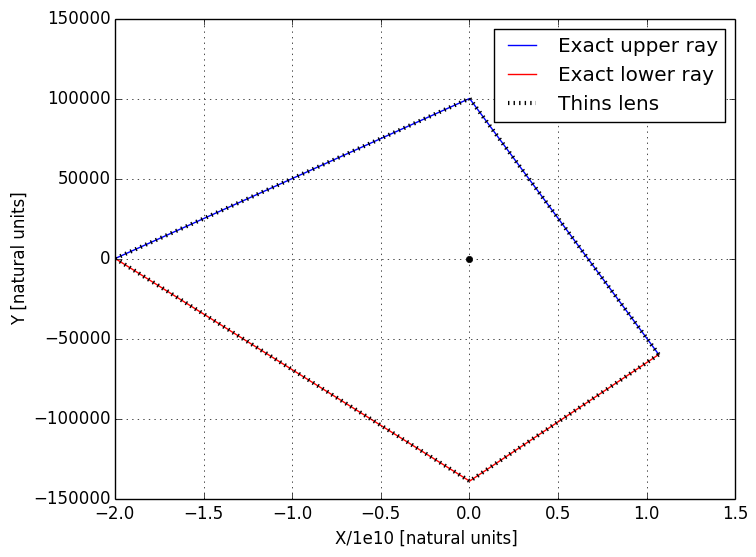

  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
in show at /Users/ariel/.julia/v0.5/PyPlot/src/PyPlot.jl


PyObject <matplotlib.legend.Legend object at 0x31b914310>

  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35
  likely near /Users/ariel/.julia/v0.5/IJulia/src/kernel.jl:35


In [10]:
tosmall(x) = [Float64(xi) for xi in x]
plot(tosmall(udx)/1e10,tosmall(udy),"-b")
hold(true)
plot(tosmall(ddx)/1e10,tosmall(ddy),"-r")
plot(tosmall(utx)/1e10,tosmall(uty),":k", lw=3)
plot(tosmall(dtx)/1e10,tosmall(dty),":k", lw=3)
plot(0,0,"ok",ms=5)
hold(false)
grid(true)
xlabel("X/1e10 [natural units]")
ylabel("Y [natural units]")
legend(["Exact upper ray","Exact lower ray","Thins lens"])
#xlim(-5e-5,5e-5)
#ylim(100062,100072)

In [11]:
function len(x,y)
    tobig(x) = [BigFloat(xi) for xi in x]
    dx = tobig(x[2:end]-x[1:(end-1)])
    dy = tobig(y[2:end]-y[1:(end-1)])
    cx = tobig(0.5*(x[1:(end-1)]+x[2:end]))
    cy = tobig(0.5*(y[1:(end-1)]+y[2:end]))
    cr = sqrt(cx.*cx+cy.*cy)
    dr = sqrt(dx.*dx+dy.*dy)
    gf = 1./sqrt(1.0-1.0./cr)
    l = sum(dr)
    gl = sum(dr.*gf)
    Float64(l), Float64(gl)
end

len (generic function with 1 method)

In [12]:
dd = len(utx,uty)[2] - len(dtx,dty)[2]

1.0016975402832031

In [13]:
dt = len(udx,udy)[2] - len(ddx,ddy)[2]

1.0017013549804688

In [14]:
_d1 = ddx[end]-dtx[end]

4.927619739567638066857805648890119170388e-11

In [15]:
_d2 = udx[end]-utx[end]

-1.270048181047766553786581006259193435219e-11

In [16]:
dt-dd

3.814697265625e-6

In [17]:
_d2-_d1

-6.197667920615404620644386655149312605607e-11

In [18]:
using VoronoiDelaunay

INFO: Precompiling module GeometricalPredicates...


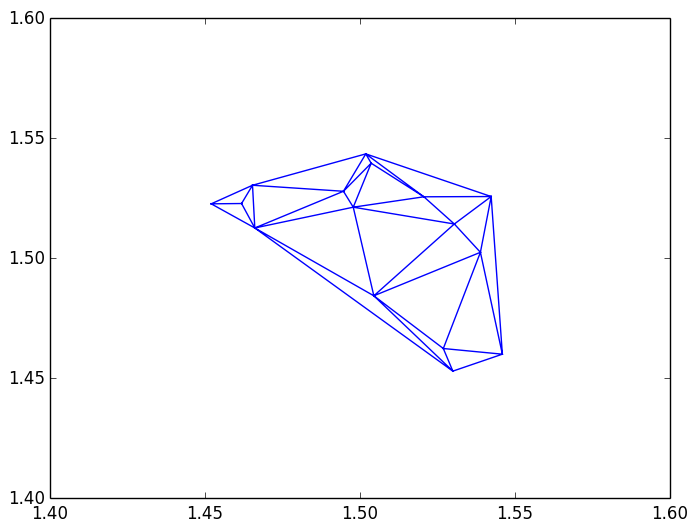

(1.4,1.6)

In [72]:
using PyPlot
tess = DelaunayTessellation()
for i in 1:16
    push!(tess, Point(rand()*0.1+1.45, rand()*0.1+1.45))
end
x,y = getplotxy(delaunayedges(tess));
plot(x,y)
xlim(1.4,1.6)
ylim(1.4,1.6)

In [ ]:
setup 1 - 3.81e-6
setup 2 - 3.81e-6